# [EX_15] 문자를 읽을 수 있는 딥러닝

# 프로젝트: 다양한 OCR모델 비교하기

#### 평가 루브릭

(1) OCR을 활용하여 구현하려는 서비스의 기획이 타당한가?  
-> 목표로 하는 서비스가 OCR를 적용 가능하며, OCR을 활용했을 때 더욱 유용해진다.  


(2) 모델 평가기준이 명확하고 체계적으로 세워졌는가?  
-> 평가 기준에 부합하는 테스트 데이터의 특징이 무엇인지 명확하게 제시되었다.


(3) 평가기준에 따라 충분한 분량의 테스트가 진행되고 그 결과가 잘 정리되었는가?  
-> 최대 20장까지의 테스트 이미지를 사용해 제시된 평가 기준에 따른 테스트 결과가 잘 정리되어 결론이 도출되었다.

## Pre-Step

### 목표 서비스:
  - 도로표지판을 인식하여 차량 자율주행 기술(Self-Driving)이나 첨단 운전자 보조 시스템(Advanced Driver Assistant System)과 같은 시스템에 도움을 줄 수 있게 한다.  
  - 한국어 인식도 중요하지만, 도로표지판이 영문도 함께 표기되므로 한글과 영문 가리지 않고 도로표지판의 핵심 내용을 검출해내는지 확인 예정.

주요 라이브러리 확인

In [1]:
import keras_ocr
import pytesseract

print(keras_ocr.__version__)
print(pytesseract.__version__)
# pytesseract는 tesseract-ocr에 종속적입니다. 아래 명령어를 통해 설치해야 할 수도 있습니다.
# !sudo apt install tesseract-ocr

0.8.8
0.3.8


## Step1. 검증용 데이터셋 준비

필요한 패키지 import

In [2]:
import matplotlib.image as pltimage
import cv2
from PIL import ImageDraw
from glob import glob

from google.cloud import vision
import io
import os
import keras_ocr

import os
from pytesseract import pytesseract as pt
from PIL import Image
from pytesseract import Output
import matplotlib.pyplot as plt

이미지 path 지정

In [3]:
dir_path = os.getenv('HOME')+'/aiffel/ocr_python/sign/'
os.listdir(dir_path)

['input_11.jpg',
 'input_3.jpg',
 'input_9.jpg',
 '.ipynb_checkpoints',
 'input_0.jpg',
 'input_4.jpg',
 'input_10.jpg',
 'input_2.jpg',
 'input_8.jpg',
 'input_6.jpg',
 'input_5.jpg',
 'input_1.jpg',
 'input_7.jpg']

In [4]:
img_path = glob(dir_path + '*.jpg')
img_path

['/aiffel/aiffel/ocr_python/sign/input_11.jpg',
 '/aiffel/aiffel/ocr_python/sign/input_3.jpg',
 '/aiffel/aiffel/ocr_python/sign/input_9.jpg',
 '/aiffel/aiffel/ocr_python/sign/input_0.jpg',
 '/aiffel/aiffel/ocr_python/sign/input_4.jpg',
 '/aiffel/aiffel/ocr_python/sign/input_10.jpg',
 '/aiffel/aiffel/ocr_python/sign/input_2.jpg',
 '/aiffel/aiffel/ocr_python/sign/input_8.jpg',
 '/aiffel/aiffel/ocr_python/sign/input_6.jpg',
 '/aiffel/aiffel/ocr_python/sign/input_5.jpg',
 '/aiffel/aiffel/ocr_python/sign/input_1.jpg',
 '/aiffel/aiffel/ocr_python/sign/input_7.jpg']

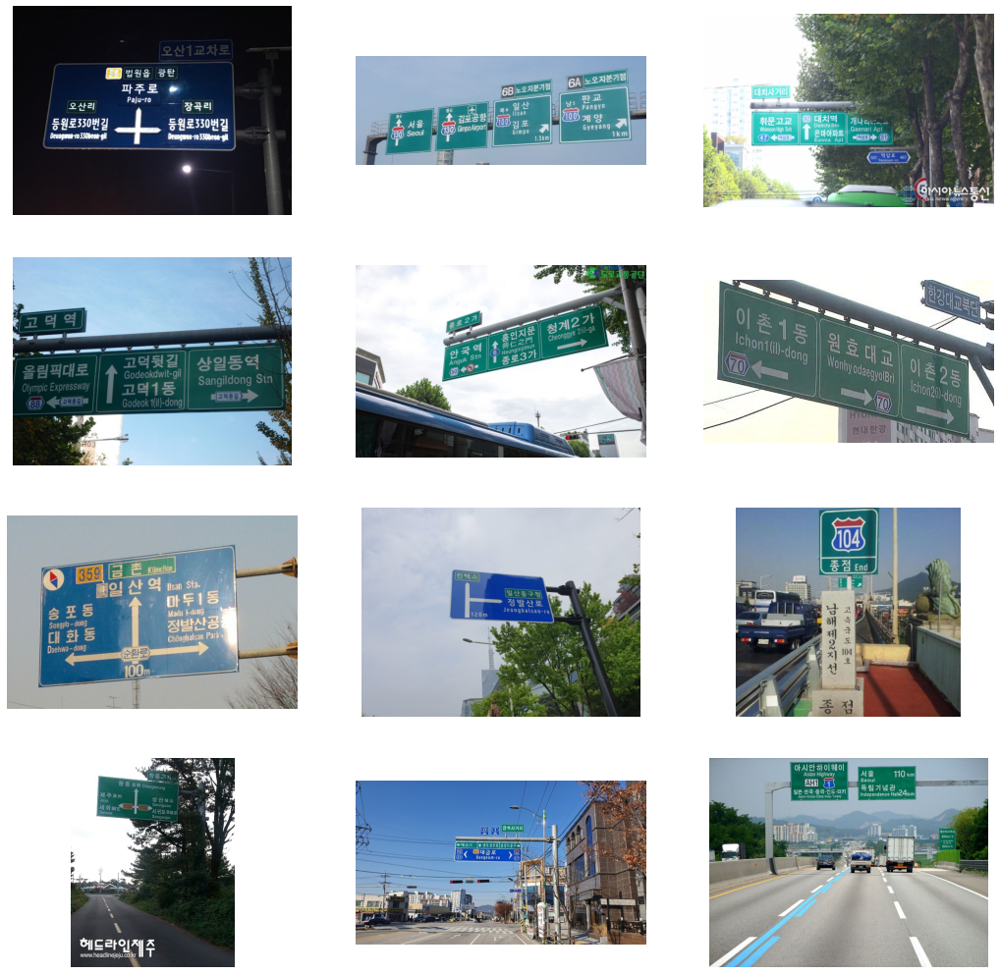

In [5]:
plt.figure(figsize=(18, 18))

for i, image in enumerate(img_path):
    plt.subplot(4, 3, i+1)
    img=pltimage.imread(image)
    plt.imshow(img)
    plt.axis('off')

일단 도로표지판 영상과 함께 야간 영상, 역광으로 인한 어두운 영상, 비스듬히 찍힌 영상 등을 테스트 이미지로 준비했다.

## Step2. Google OCR API, keras-ocr, Tesseract로 테스트 진행

이미지에 글자 디텍션 결과를 띄워보자.  
인식된 글자는 다음 step에서 확인

### Google OCR API

In [6]:
def draw_boxes(image, bounds):
    # 박스를 그리는 함수 정의
    draw = ImageDraw.Draw(image)

    for bound in bounds:
        draw.polygon([
            bound.vertices[0].x, bound.vertices[0].y,
            bound.vertices[1].x, bound.vertices[1].y,
            bound.vertices[2].x, bound.vertices[2].y,
            bound.vertices[3].x, bound.vertices[3].y], None, 'yellow')
    return image

In [7]:
def detect_text(path):
    """Detects text in the file."""
    text_dec = []
    bounds = []
    client = vision.ImageAnnotatorClient()

    with io.open(path, 'rb') as image_file:
        content = image_file.read()
    
    s = os.path.splitext(path)
    s = os.path.split(s[0])
    name = s[1]
    
    image = vision.Image(content=content)

    response = client.text_detection(image=image)
    texts = response.text_annotations
    #print('Texts:')

    for text in texts:
        text_dec.append(text.description.replace('\n',''))
        vertices = text.bounding_poly
        bounds.append(vertices)        
        #print('\n"{}"'.format(text.description))

    vertices = (['({},{})'.format(vertex.x, vertex.y)
                 for vertex in text.bounding_poly.vertices])

    #print('bounds: {}'.format(','.join(vertices)))

    if response.error.message:
        raise Exception(
            '{}\nFor more info on error messages, check: '
            'https://cloud.google.com/apis/design/errors'.format(
                response.error.message))
        
    return name, text_dec, bounds

In [9]:
# 로컬 환경에서는 다운받은 인증키 경로가 정확하게 지정되어 있어야 합니다. 
# 클라우드 환경에서는 무시해도 좋습니다
!ls -l $GOOGLE_APPLICATION_CREDENTIALS

os.environ["GOOGLE_APPLICATION_CREDENTIALS"] =  os.getenv('HOME')+'/aiffel/ocr_python/my_google_api_key.json'

ocr_img = []
ocr_img_idx = {}
ocr_dict = {}

# 입력 이미지 경로를 지정해 주세요.
#path = img_path

# 위에서 정의한 OCR API 이용 함수를 호출해 봅시다.
for i, path in enumerate(img_path):
    name, text_dec, bounds = detect_text(path)
    ocr_dict[name] = text_dec
    image = Image.open(path)
    draw_boxes(image, bounds)
    ocr_img.append(image)
    ocr_img_idx[name] = i
#detect_text(path)

-rw-r--r-- 1 root root 2336 Mar  3 17:14 /aiffel/aiffel/ocr_python/my_google_api_key.json


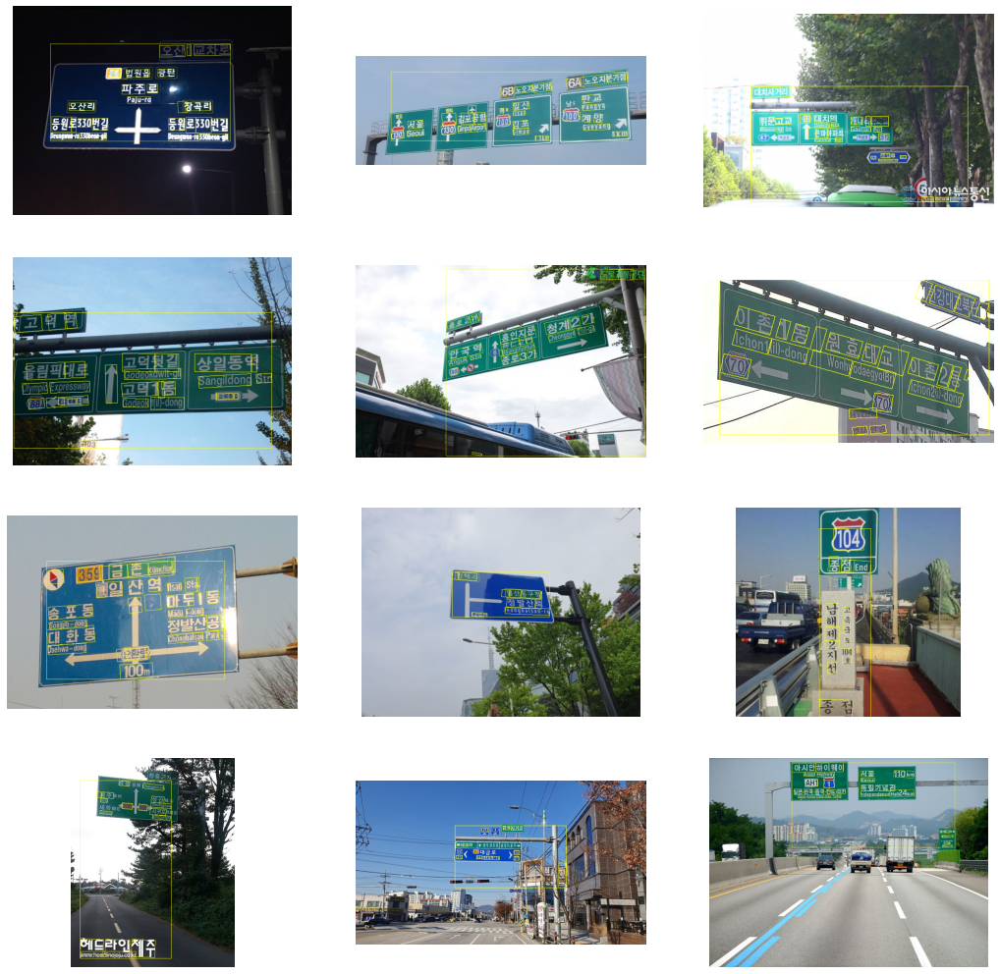

In [10]:
plt.figure(figsize=(18, 18))

for i, image in enumerate(ocr_img):
    plt.subplot(4, 3, i+1)
    plt.imshow(image)
    plt.axis('off')

인식된 글자를 확인해보지는 않았지만 detection box 결과가 글자에 딱 맞게 잘 검출된 것을 볼 수 있다.

### keras-ocr

In [11]:
# keras-ocr이 detector과 recognizer를 위한 모델을 자동으로 다운로드받게 됩니다. 
pipeline = keras_ocr.pipeline.Pipeline()

Looking for /aiffel/.keras-ocr/craft_mlt_25k.h5
Looking for /aiffel/.keras-ocr/crnn_kurapan.h5


In [12]:
images = [ keras_ocr.tools.read(img) for img in img_path]
prediction_groups = [pipeline.recognize([img]) for img in img_path]

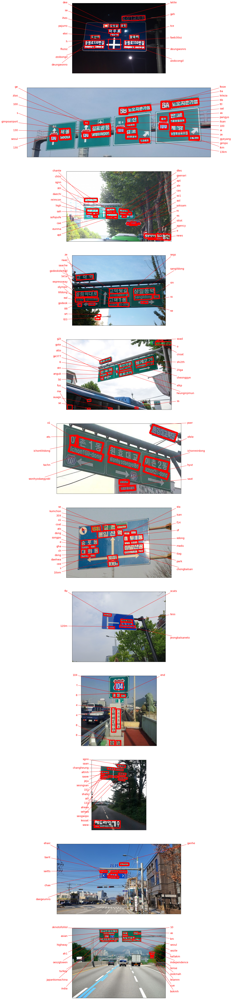

In [13]:
# Plot the predictions
fig, axs = plt.subplots(12, figsize=(18, 100))
for idx, ax in enumerate(axs):
    keras_ocr.tools.drawAnnotations(image=images[idx], 
                                    predictions=prediction_groups[idx][0], ax=ax)
    
#for i in range(len(axs)):
#    for j in range(len(axs[i])):
#        keras_ocr.tools.drawAnnotations(image=images[3*i+j], 
#                                    predictions=prediction_groups[3*i+j][0], ax=axs[i,j])

기본 제공하는 방법이 글자 인식 결과를 바로 표시하므로 바로 확인 가능.  
한글 인식이 안되지만 표지판의 영문 표기는 비교적 정확히 인식

### Tesseract

In [14]:
def crop_word_regions_kor(image_path, output_path):
    s = os.path.splitext(image_path)
    s = os.path.split(s[0])
    name = s[1]
    output_path = output_path + name +'/'
    
    if not os.path.exists(output_path):
        os.mkdir(output_path)
    custom_oem_psm_config = r'--oem 3 --psm 3'
    image = Image.open(image_path)
    img = cv2.imread(image_path)
    
    d = pt.image_to_data(
        image, lang='kor',    # 한국어라면 lang='kor'
        config=custom_oem_psm_config,
        output_type=Output.DICT
    )
    
    n_boxes = len(d['text'])
    for i in range(n_boxes):
        if int(d['conf'][i]) > 60:
            (x, y, w, h) = (d['left'][i], d['top'][i], d['width'][i], d['height'][i])
            img = cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    top_level = max(d['level'])
    index = 0
    cropped_image_path_list = []
    for i in range(len(d['level'])):
        level = d['level'][i]
    
        if level == top_level:
            left = d['left'][i]
            top = d['top'][i]
            width = left + d['width'][i]
            height = top + d['height'][i]
            if width == 0: 
                width = 1
            if height == 0:
                height = 1
            
            output_img_path = os.path.join(output_path, f"{str(index).zfill(4)}.png")
            cropped_image = image.crop((
                left,
                top,
                width,
                height
            ))
            cropped_image.save(output_img_path)
            cropped_image_path_list.append(output_img_path)
            index += 1
    return name, cropped_image_path_list, img


work_dir = os.getenv('HOME')+'/aiffel/ocr_python'
output_path = work_dir + '/output/kor/' 

이미지를 크롭하는 과정에서 width가 0이 되어 오류가 발생하기도 함. 그러므로 예외 처리를 해줌

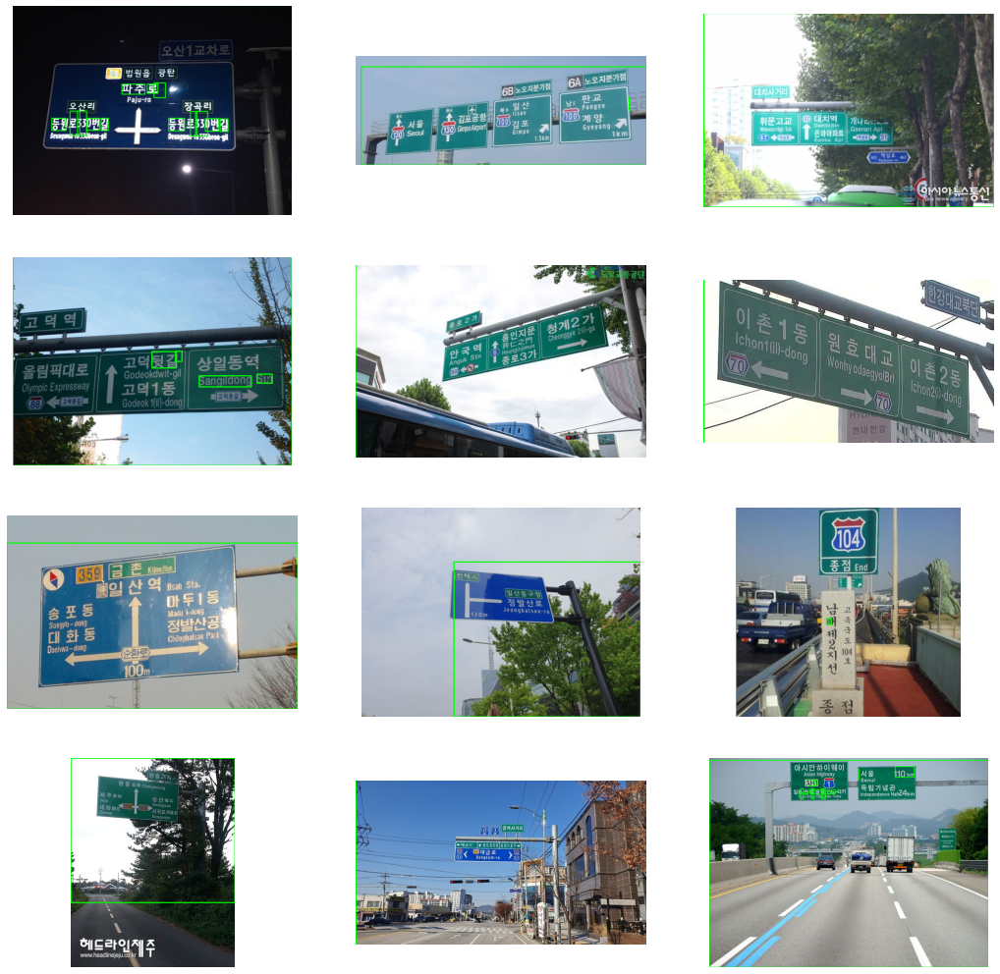

In [15]:
Tesser_dict_kor = {}
img_dict_kor = {}
plt.figure(figsize=(18, 18))

for idx, path in enumerate(img_path):    
    name, cropped_image_path_list_kor, imgs = crop_word_regions_kor(path, output_path)
    Tesser_dict_kor[name] = cropped_image_path_list_kor
    img_dict_kor[name] = imgs
    plt.subplot(4, 3, idx+1)
    plt.imshow(imgs)
    plt.axis('off')

한글 검출을 시도했지만 검출 결과가 상당히 좋지 않음

In [108]:
def recognize_images_kor(cropped_image_path_list):
    test = []
    custom_oem_psm_config = r'--oem 3 --psm 7'
    
    for image_path in cropped_image_path_list:
        image = Image.open(image_path)
        recognized_data = pt.image_to_string(
            image, lang='kor',    # 한국어라면 lang='kor'
            config=custom_oem_psm_config,
            output_type=Output.DICT
        )
        test.append(recognized_data['text'].replace('\n', '').replace('\x0c',''))
        
    print(test)
    print("Done")

영문으로 다시 시도

In [104]:
def crop_word_regions_eng(image_path, output_path):
    s = os.path.splitext(image_path)
    s = os.path.split(s[0])
    name = s[1]
    output_path = output_path + name +'/'
    
    if not os.path.exists(output_path):
        os.mkdir(output_path)
    custom_oem_psm_config = r'--oem 3 --psm 11'
    image = Image.open(image_path)
    img = cv2.imread(image_path)
    
    d = pt.image_to_data(
        image, lang='eng',    # 한국어라면 lang='kor'
        config=custom_oem_psm_config,
        output_type=Output.DICT
    )
    
    n_boxes = len(d['text'])
    for i in range(n_boxes):
        if int(d['conf'][i]) > 60:
            (x, y, w, h) = (d['left'][i], d['top'][i], d['width'][i], d['height'][i])
            img = cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    top_level = max(d['level'])
    index = 0
    cropped_image_path_list = []
    for i in range(len(d['level'])):
        level = d['level'][i]
    
        if level == top_level:
            left = d['left'][i]
            top = d['top'][i]
            width = left + d['width'][i]
            height = top + d['height'][i]
            
            output_img_path = os.path.join(output_path, f"{str(index).zfill(4)}.png")
            cropped_image = image.crop((
                left,
                top,
                width,
                height
            ))
            cropped_image.save(output_img_path)
            cropped_image_path_list.append(output_img_path)
            index += 1
    return name, cropped_image_path_list, img


work_dir = os.getenv('HOME')+'/aiffel/ocr_python'
output_path = work_dir + '/output/eng/' 

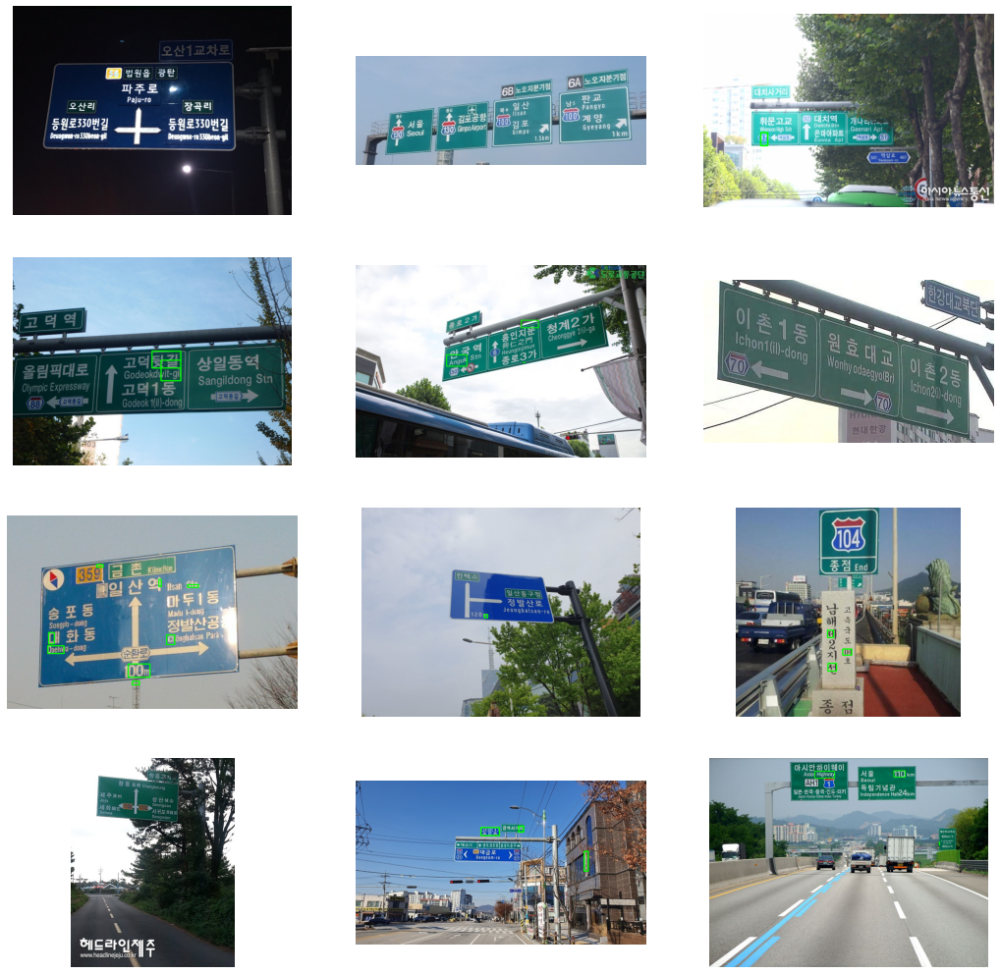

In [105]:
Tesser_dict_eng = {}
img_dict_eng = {}
plt.figure(figsize=(18, 18))

for idx, path in enumerate(img_path):    
    name, cropped_image_path_list_eng, imgs = crop_word_regions_eng(path, output_path)
    Tesser_dict_eng[name] = cropped_image_path_list_eng
    img_dict_eng[name] = imgs
    plt.subplot(4, 3, idx+1)
    plt.imshow(imgs)
    plt.axis('off')

영문으로 다시 시도해봤지만 역시나 결과가 좋지 못하다

In [91]:
def recognize_images_eng(cropped_image_path_list):
    test = []
    custom_oem_psm_config = r'--oem 3 --psm 7'
    
    for image_path in cropped_image_path_list:
        image = Image.open(image_path)
        recognized_data = pt.image_to_string(
            image, lang='eng',    # 한국어라면 lang='kor'
            config=custom_oem_psm_config,
            output_type=Output.DICT
        )
        test.append(recognized_data['text'].replace('\n', '').replace('\x0c',''))
        
    print(test)
    print("Done")

## Step3. 테스트 결과 정리

Google OCR API 결과 확인

### \# input_0

['고 덕 역올림픽대로Olympic Expressway↑고덕뒷길 상일동역Godeokdwit-gilSangildong Sin고덕 1동Godeok 1(il)-dong88 E45(고덕동길|고덕동길103', '고', '덕', '역', '올림픽', '대로', 'Olympic', 'Expressway', '↑', '고덕', '뒷길', '상일동', '역', 'Godeokdwit-gil', 'Sangildong', 'Sin', '고덕', '1', '동', 'Godeok', '1(il)-dong', '88', 'E45', '(', '고덕동', '길', '|', '고덕동', '길', '103']


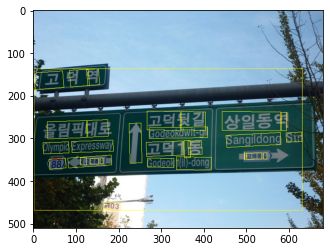

In [21]:
print(ocr_dict['input_0'])
plt.imshow(ocr_img[ocr_img_idx['input_0']])

keras-ocr 결과 확인

AxesSubplot(0.125,0.125;0.775x0.755)


<Figure size 7200x7200 with 0 Axes>

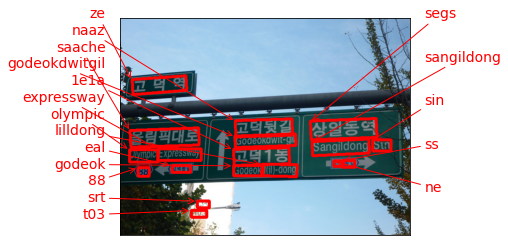

In [25]:
plt.figure(figsize=(100, 100))
keras_img = keras_ocr.tools.drawAnnotations(image=images[ocr_img_idx['input_0']], predictions=prediction_groups[ocr_img_idx['input_0']][0])
print(keras_img)

Tesseract 결과 확인

['므너', '=', ']', '호', '|', '', '', '|', '바', '기', '', '덩1 동 |', '(01', '이이', '이', '|', '게 |동길) .', '5', ' 는 「 6']
Done


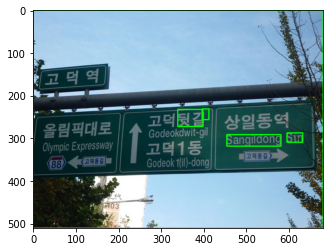

In [109]:
plt.imshow(img_dict_kor['input_0'])
# 위에서 준비한 문자 영역 파일들을 인식하여 얻어진 텍스트를 출력합니다.
recognize_images_kor(Tesser_dict_kor['input_0'])

* 세 가지 방법의 결과를 출력하는 함수 생성

In [73]:
def check_google(name):
    print('\n[Google OCR API 결과]\n')
    print(ocr_dict[name])
    plt.figure(figsize=(18, 18))
    plt.imshow(ocr_img[ocr_img_idx[name]])
    
def check_keras(name):
    print('\n[keras ocr 결과]\n')
    plt.figure(figsize=(18, 18))
    keras_ocr.tools.drawAnnotations(image=images[ocr_img_idx[name]], predictions=prediction_groups[ocr_img_idx[name]][0])
    
def check_tesseract(name):
    print('\n[Tesseract 결과]\n')
    recognize_images_kor(Tesser_dict_kor[name])
    plt.figure(figsize=(18, 18))
    plt.imshow(img_dict_kor[name])
    
def check_tesseract_(name):
    print('\n[Tesseract 결과]\n')
    recognize_images_eng(Tesser_dict_eng[name])
    plt.figure(figsize=(18, 18))
    plt.imshow(img_dict_eng[name])

### \# input_1


[Google OCR API 결과]

['금석 사거리21|←대소IC4032(21Daegeum-ro道', '금석', '사거리', '21', '|', '←', '대소', 'IC', '40', '32', '(21', 'Daegeum-ro', '道']


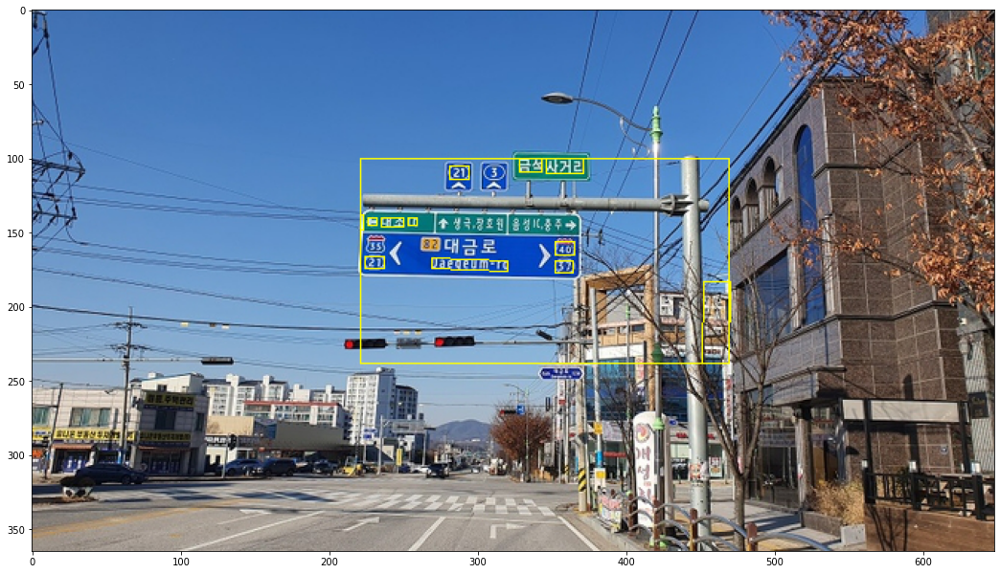

In [53]:
check_google('input_1')


[keras ocr 결과]



<Figure size 1296x1296 with 0 Axes>

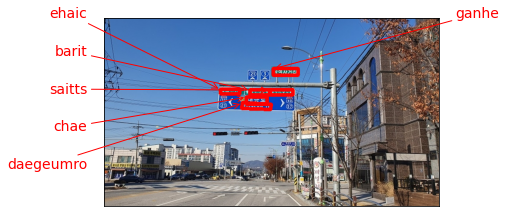

In [55]:
check_keras('input_1')


[Tesseract 결과]

['']
Done


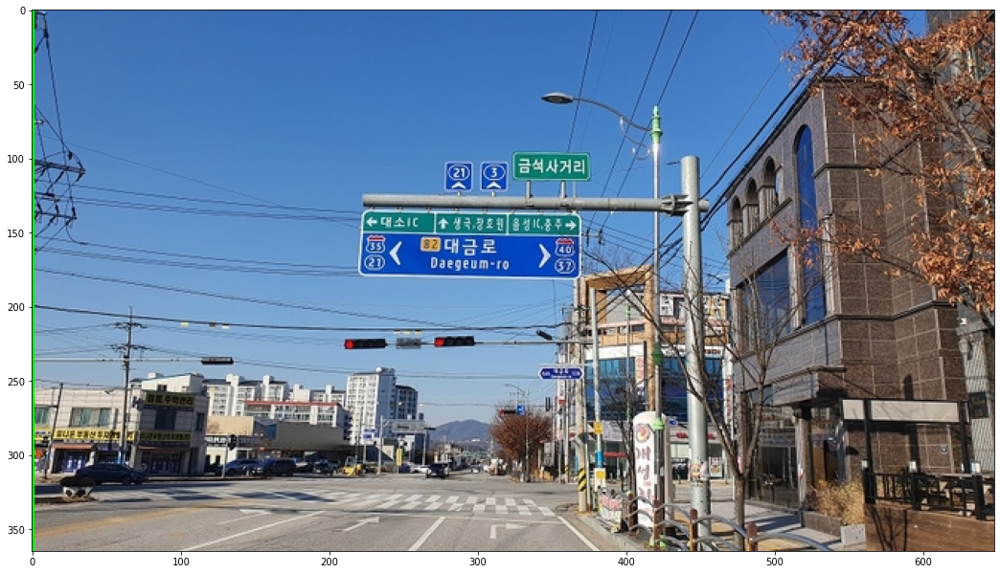

In [110]:
check_tesseract('input_1')


[Tesseract 결과]

['if', '{i', 'a)', 'el', '(', 'oy', '4 +', ';', '', 'come', '—_', 'lll', '', 'a', 'Be', '|', '|', 'diese', '']
Done


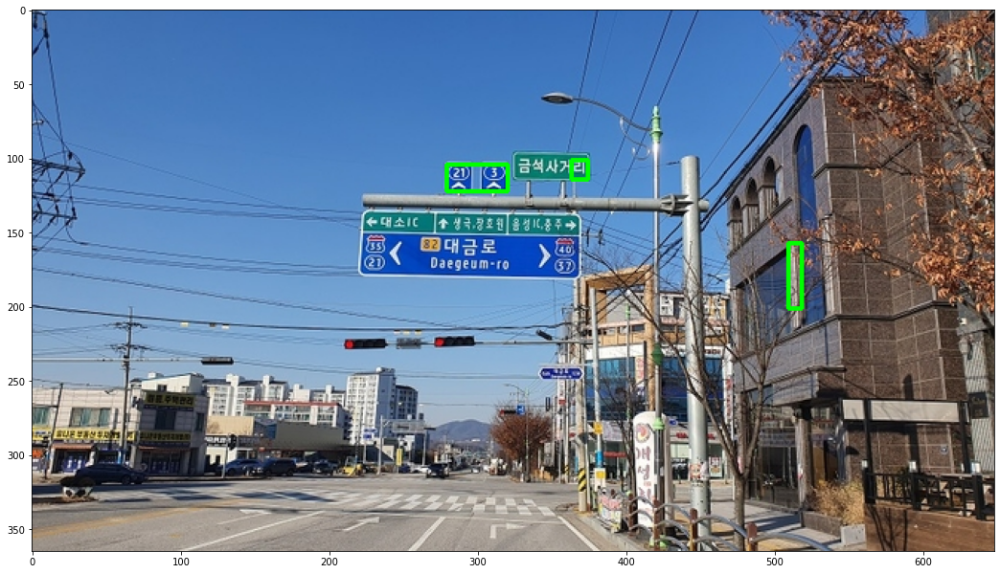

In [94]:
check_tesseract_('input_1')

### \# input_2


[Google OCR API 결과]

['4 359금 존 Kimnehion)일 산 역 Iisan Sta.솥: 마두1동정발산공!송포동Songpo-dongMadu -dong대화동Daehwa-dongChōngbalsan Park ,<순환로)100m', '4', '359', '금', '존', 'Kimnehion', ')', '일', '산', '역', 'Iisan', 'Sta', '.', '솥', ':', '마두', '1', '동', '정발산', '공', '!', '송포동', 'Songpo-dong', 'Madu', '-dong', '대화동', 'Daehwa-dong', 'Chōngbalsan', 'Park', ',', '<', '순환로', ')', '100m']


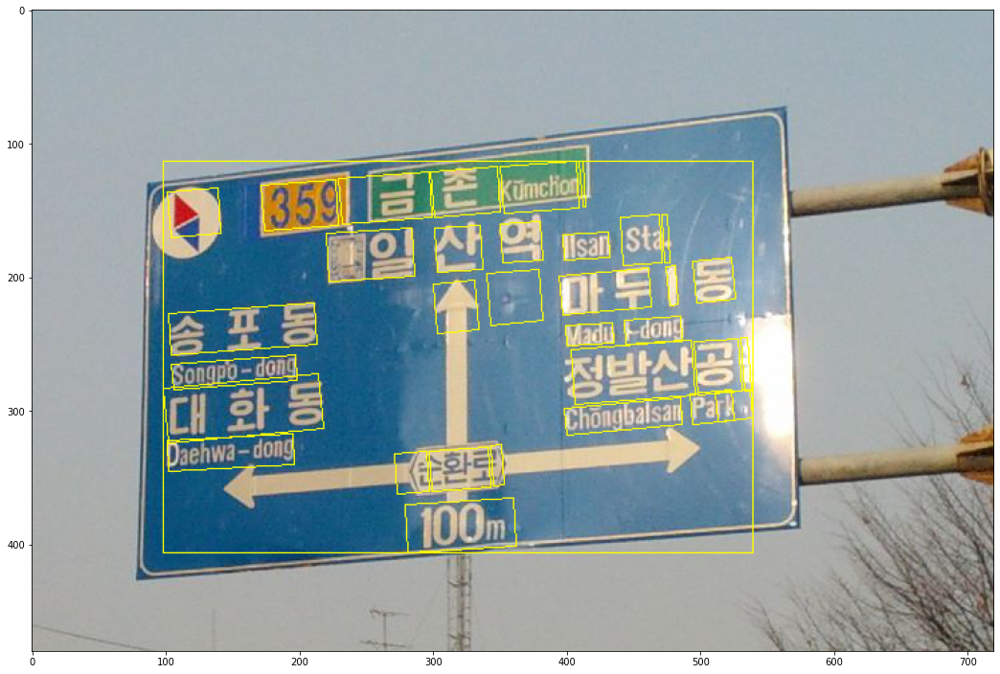

In [57]:
check_google('input_2')


[keras ocr 결과]



<Figure size 1296x1296 with 0 Axes>

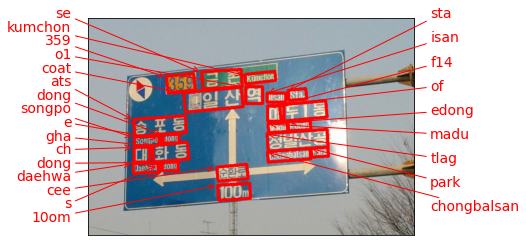

In [58]:
check_keras('input_2')


[Tesseract 결과]

['을 트']
Done


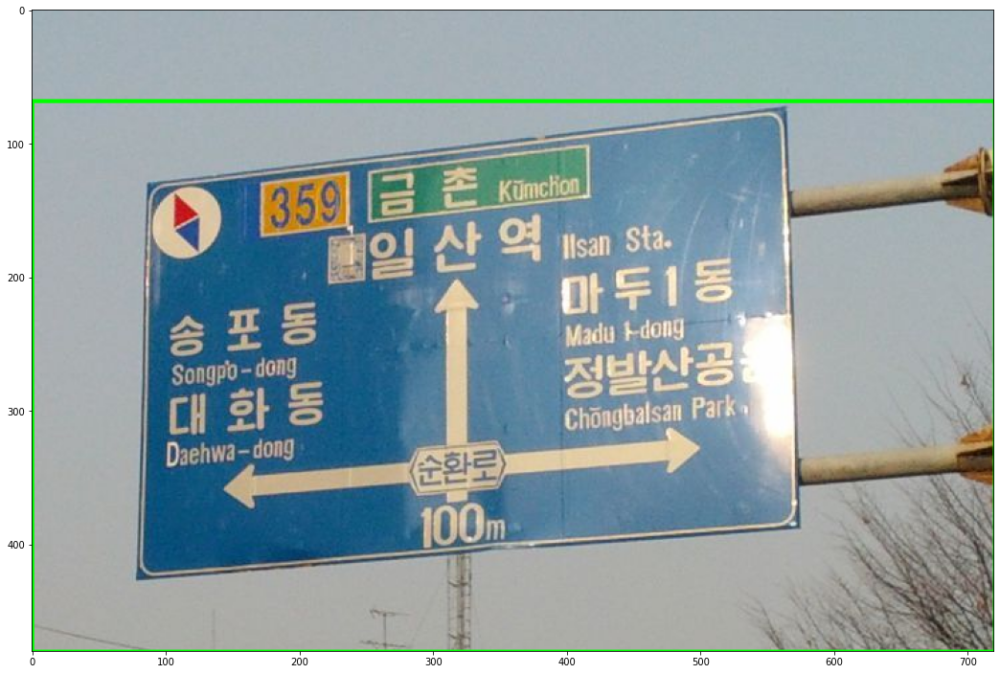

In [111]:
check_tesseract('input_2')


[Tesseract 결과]

['—', '', 'meee, =', '—', 'ro.', '"A abt', '2', 're:', '> & te', 'oO}', 'ee FS', '|', 'Isat', 'i=', 'nel', 'Peon i', 'e', 'aol DOLE', 'mei itiit', 'with)', 'am', '', 'I', '|', '*', 'co', 'Ch', 'Hie', 'Naehv', ', i', 'a_i', 'i.', '', 'Sie', '‘', '', 'tn', 'all', 'aS ——', 'ah', '1a', '——', '5"']
Done


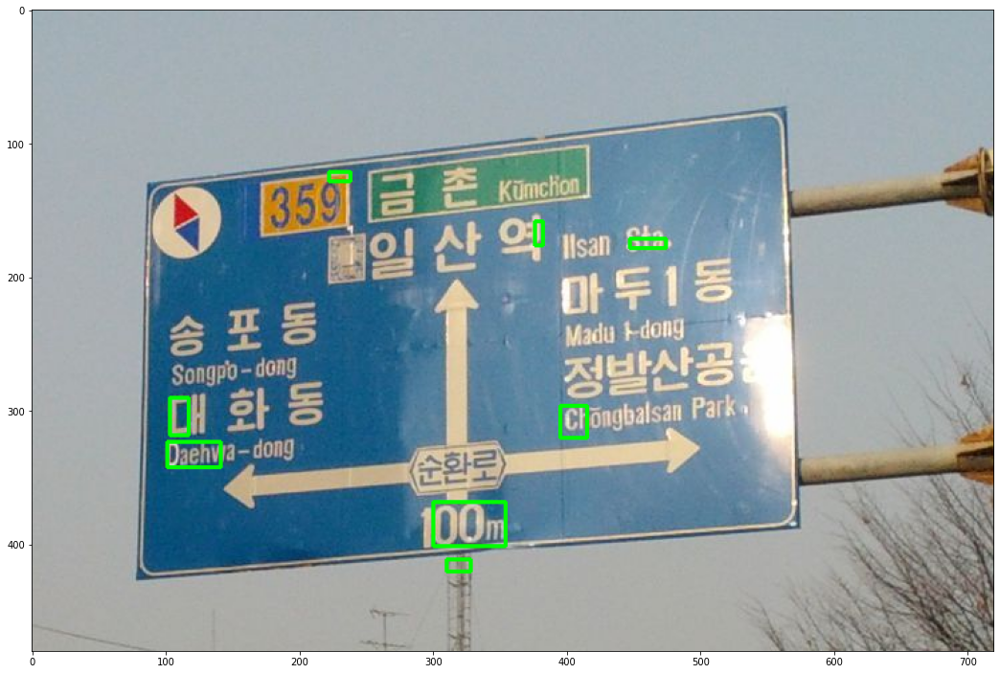

In [95]:
check_tesseract_('input_2')

### \# input_3


[Google OCR API 결과]

["16A노오지분기점|6B노오지분기점)판교Pangyo100 계 양일산동ESE서울130 Seoul소 김포공항130 Gimpo Airport북NIlsan100'김포GimpoGyeyang1.3km1km", '16A', '노오지', '분기점', '|', '6B', '노오지', '분기점', ')', '판교', 'Pangyo', '100', '계', '양', '일산', '동', 'E', 'SE', '서울', '130', 'Seoul', '소', '김포', '공항', '130', 'Gimpo', 'Airport', '북', 'N', 'Ilsan', '100', "'", '김포', 'Gimpo', 'Gyeyang', '1.3km', '1km']


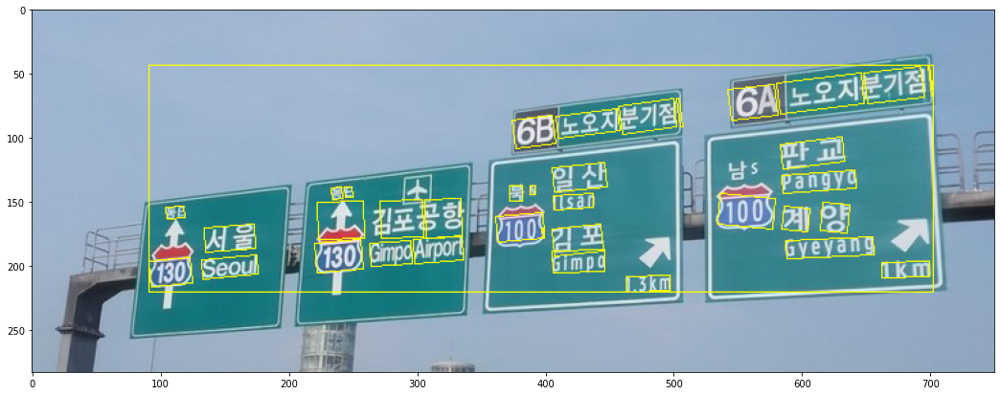

In [60]:
check_google('input_3')


[keras ocr 결과]



<Figure size 1296x1296 with 0 Axes>

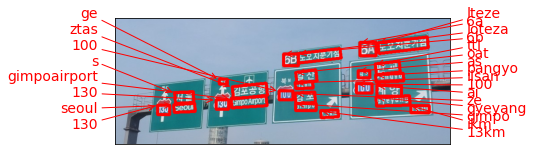

In [61]:
check_keras('input_3')


[Tesseract 결과]

['', '']
Done


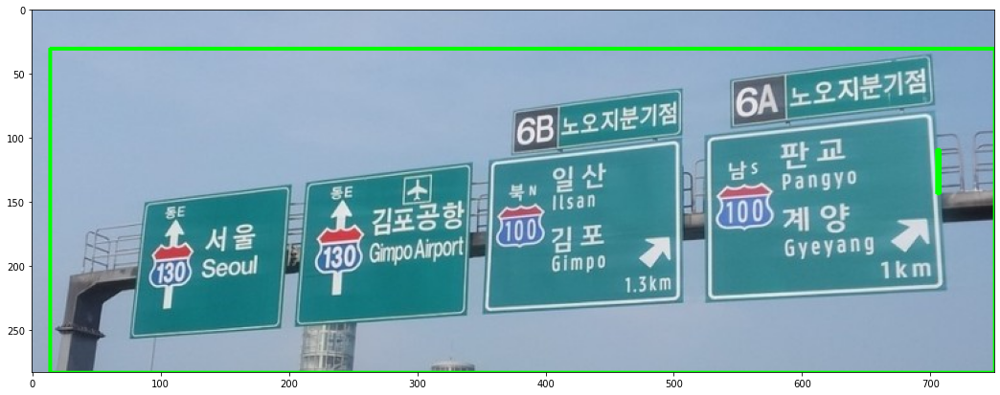

In [112]:
check_tesseract('input_3')


[Tesseract 결과]

['ts', 'Pangyo', 'eT', '5', 'rd fre', '', 'Gyeyand', 'Tet', 'Lh', 'Bi']
Done


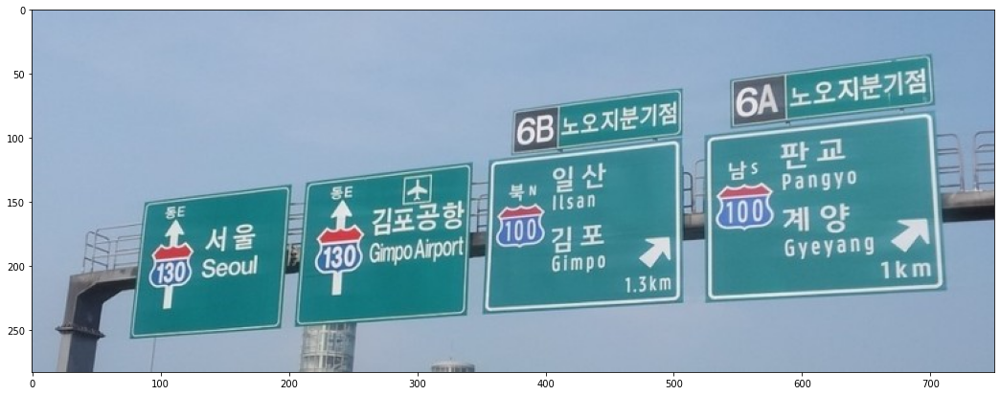

In [96]:
check_tesseract_('input_3')

### \# input_4


[Google OCR API 결과]

['도로고통공단종로 2가|안국역Anguk Stn50흥인지문 청계2가興仁之門O Heunginjimun종로3가Cheonggye 2(i)-gaOMAOR', '도로', '고통', '공단', '종로', '2', '가', '|', '안국역', 'Anguk', 'Stn', '50', '흥인지문', '청계', '2', '가', '興仁', '之', '門', 'O', 'Heunginjimun', '종로', '3', '가', 'Cheonggye', '2(i)-ga', 'OMAOR']


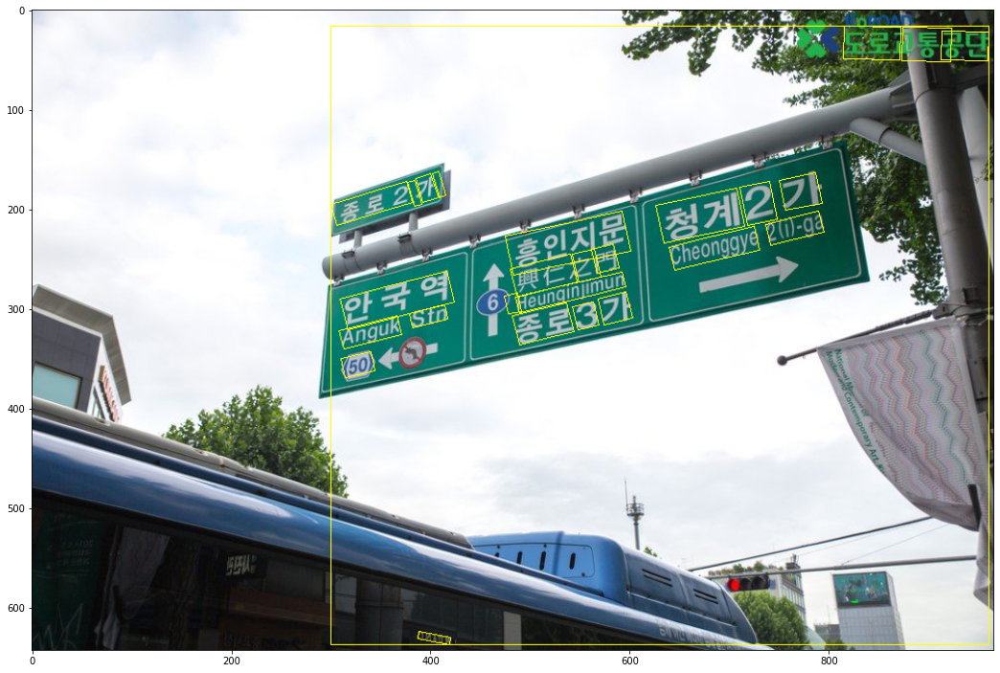

In [63]:
check_google('input_4')


[keras ocr 결과]



<Figure size 1296x1296 with 0 Axes>

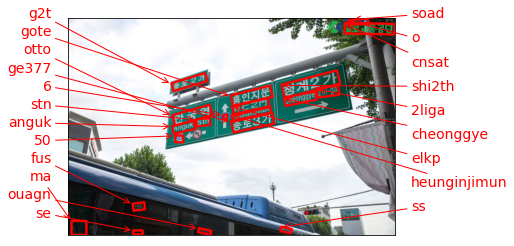

In [64]:
check_keras('input_4')


[Tesseract 결과]

['']
Done


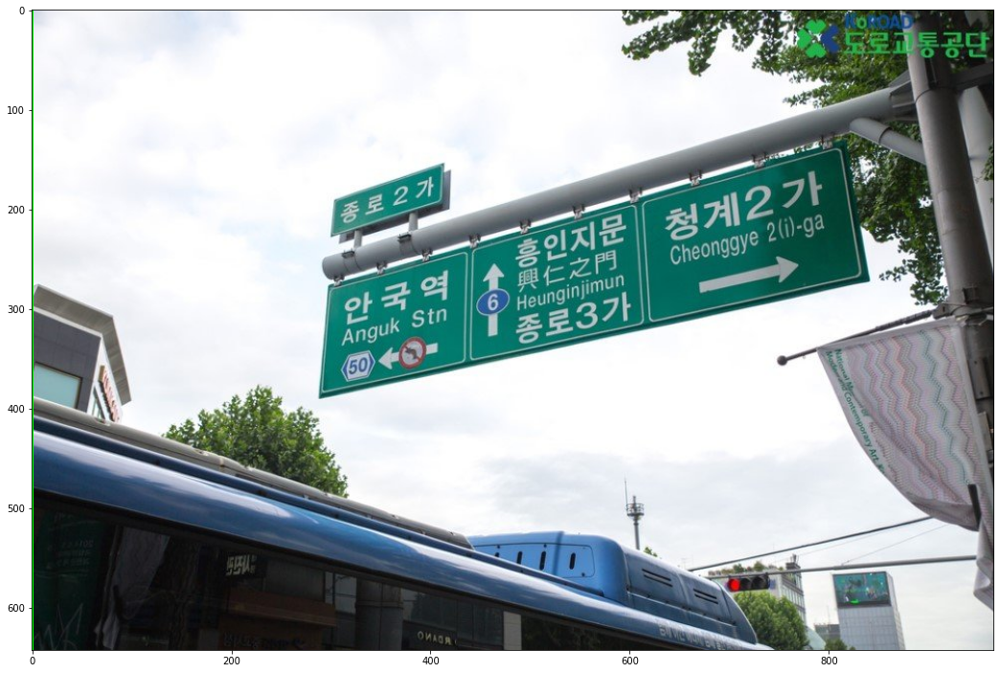

In [113]:
check_tesseract('input_4')


[Tesseract 결과]

['', 'a', 'a', '==', 'y,\\', 'Acuna', '|', '', 'Anguk', 'Stn', '', 'oe', '_', 'v7', 'J', 'r', '7', 'a']
Done


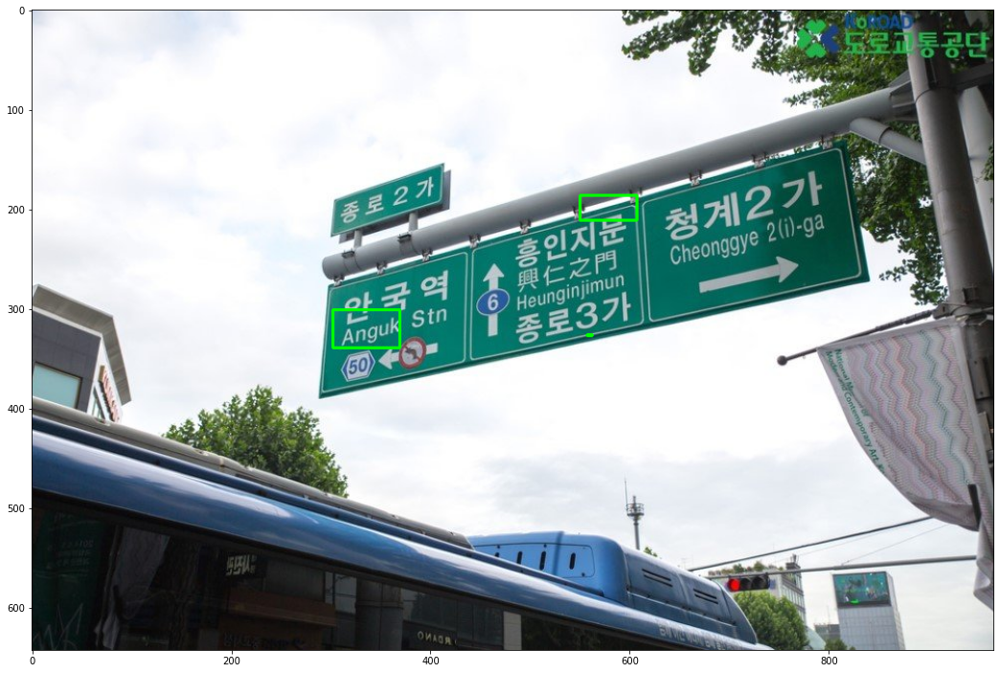

In [97]:
check_tesseract_('input_4')

### \# input_5


[Google OCR API 결과]

['창흥 Changheung|제주Jeju성산Seongsan서귀포Seogwipo1132 1132Sehwa헤드라인제주www.headlinejeju.co.kr', '창흥', 'Changheung', '|', '제주', 'Jeju', '성산', 'Seongsan', '서귀포', 'Seogwipo', '1132', '1132', 'Sehwa', '헤드', '라인', '제주', 'www.headlinejeju.co.kr']


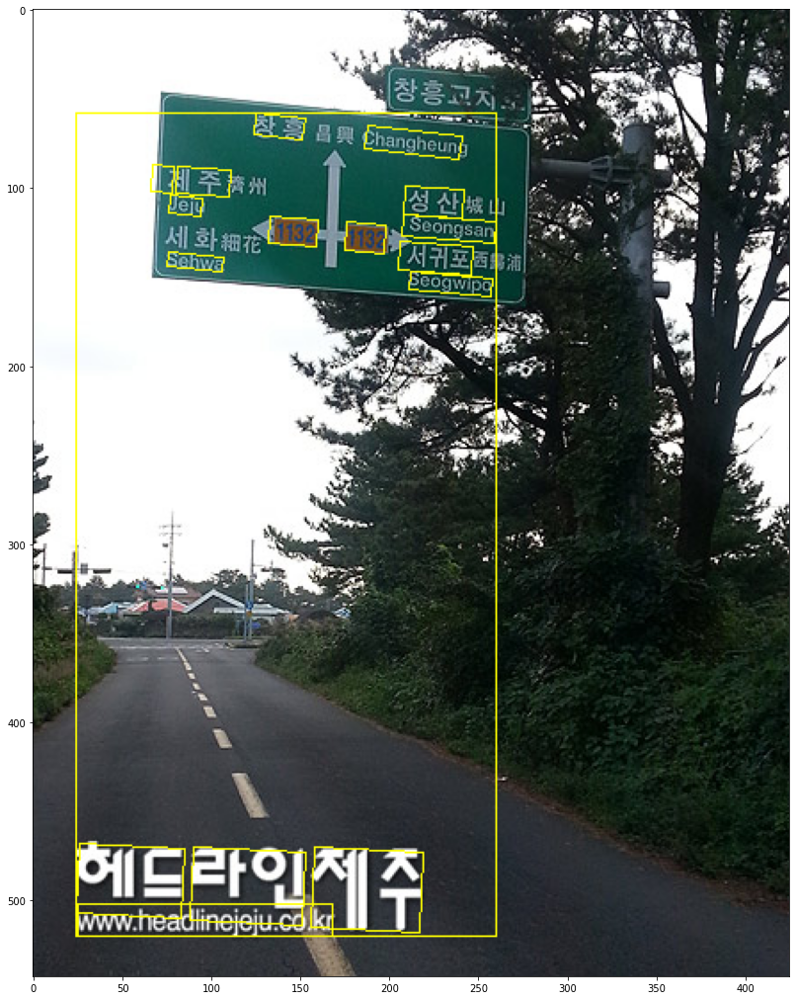

In [66]:
check_google('input_5')


[keras ocr 결과]



<Figure size 1296x1296 with 0 Axes>

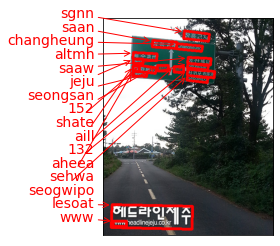

In [67]:
check_keras('input_5')


[Tesseract 결과]

['', 'ㅣ', '은', '', '', '/', '16', '히[', '(1),']
Done


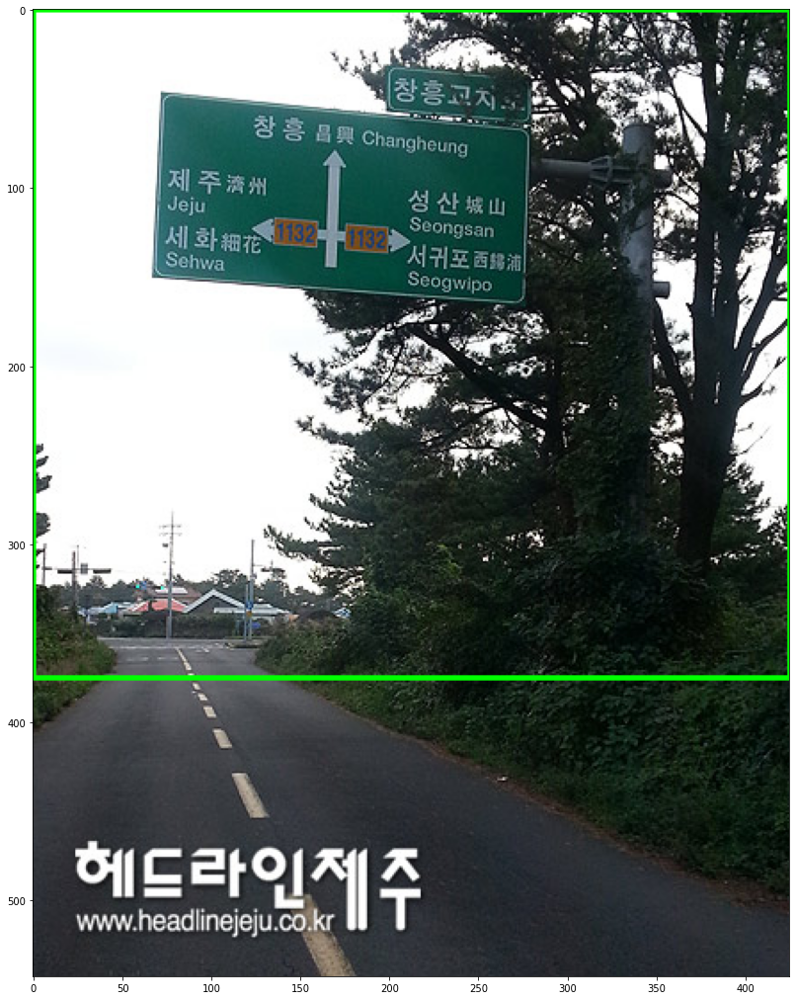

In [114]:
check_tesseract('input_5')


[Tesseract 결과]

['', 'ad', 'ie', 'a', 'oe', 'Peres', 'an', 'oe)', 'abe']
Done


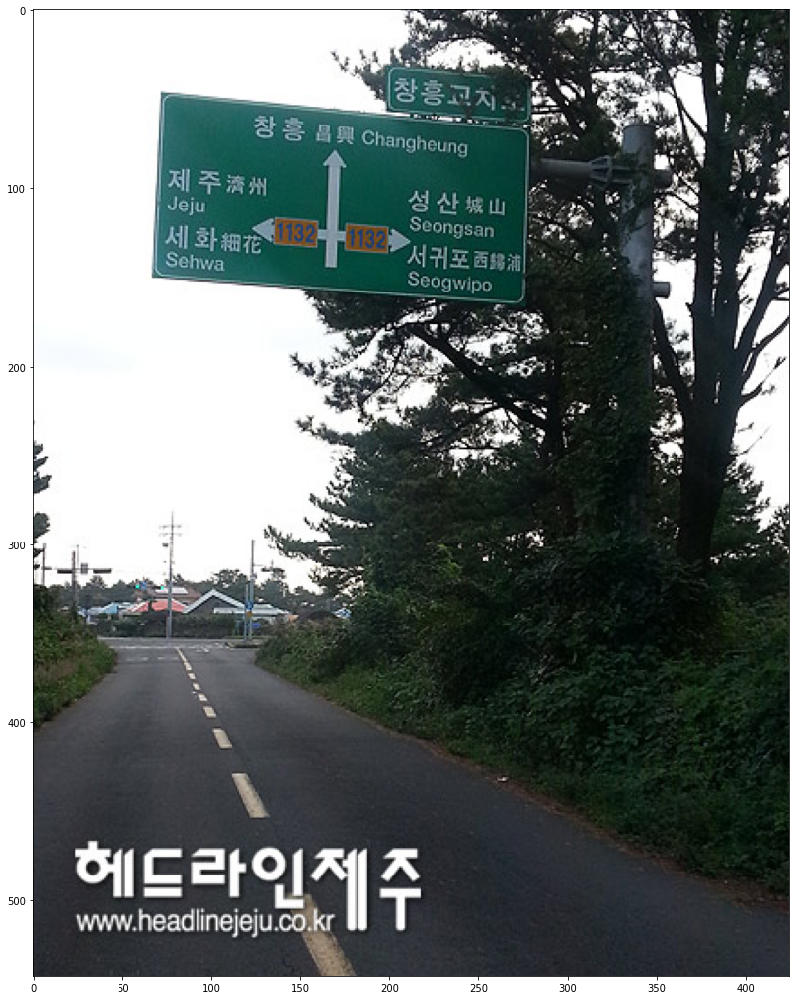

In [107]:
check_tesseract_('input_5')

## Step4. 결과 분석과 결론 제시

* 도로 표지판에 포함된 글자를 모두 인식하는지 확인
* 한글을 인식하는지 확인
* 영문을 인식하는지 확인
* 인식한 글자가 정확한지 확인

#### Google OCR API
* 한글과 영문, 숫자까지 모두 아주 정확히 인식하는 모습을 보여준다.  
* 모든 글자를 인식하지는 못했지만 한글과 영문을 동시에 인식하는것이 장점

#### keras-ocr
* 한글은 인식하지 못한다.
* 영문은 거의 오차 없이 매우 정확하게 인식하고 있다.

#### Tesseract
* 한글로 인식했을 때, 사실상 하나도 인식하지 못하는 모습을 볼 수 있다.
* 영문으로 인식했을 때도 마찬가지로 거의 인식하지 못하고 엉뚱한 결과를 내놓는다.

### <font color=blue> 종합 </font>
* 결과적으로 성능은 Google OCR API와 keras-ocr 둘 모두 좋다.
* 도로표지판을 인식하는 것이므로 영문과 한글을 모두 인식할 수 있는 것이 더욱 확실하므로, 한글과 영문은 물론, 한자까지 인식하는 Google OCR API가 가장 좋은 성능을 보인다.

#### -> 결론: Google OCR API를 이용하여 도로 표지판을 인식해야 차량 운전 보조시스템에 효과적으로 적용이 가능하다!

---

# 회고

* 이미지에서 글자를 인식하는 원리에 대해 처음 알게 되었다. 기본적으로 글자 영역을 먼저 detection하는 과정이 정확히 이루어져야 어떤 글자인지도 정확히 인식할 수 있을것이다.

* 글자를 인식하기 위해서는 데이터의 양이 매우 중요한 것 같다. 실제 인식해야하는 글자들은 글자의 크기가 다양하고 밝기도 다양하며, 회전되거나 기울어져 있는 등의 많은 방해요소를 가지고 있다. 이러한 데이터에 대응하기 위한 augmentation이 중요할 것이다.

* 다양한 나라의 언어를 다룰수록 활용하기에 편리하다고 느꼈다. keras-ocr의 경우 영문은 아주 정확히 글자를 인식하지만 영문에만 한정되어 있기에 활용도가 매우 떨어진다. 반면, Google OCR API는 정확도도 높으면서 영문, 한글, 한자를 모두 인식하는 모습을 보여주어 어떤 시스템에 적용할 때 굉장히 효과적이다.